In [219]:
import numpy as np 
import matplotlib.pyplot as plt
import glob
import cv2
import os
import seaborn as sns
import pandas as pd
from skimage.filters import sobel
from skimage.feature import greycomatrix, greycoprops
from skimage.measure import shannon_entropy


In [220]:
DATADIR = ("input/uisketch")
CATEGORIES = ['button', 'card','image']
SIZE = 150

In [221]:
train_images = []
train_labels = [] 
def create_training_data():
    for i in range(len(CATEGORIES)):
        category = CATEGORIES[i]
        path = os.path.join(DATADIR, category)
        for img in os.listdir(path):
            img_array = cv2.imread(os.path.join(path,img),0)
            new_array = cv2.resize(img_array, (SIZE, SIZE))
       
            train_images.append(new_array)
            train_labels.append(i)

create_training_data()
len(train_images)

3248

In [222]:
train_images = np.array(train_images)
train_labels = np.array(train_labels)


In [223]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(train_images, train_labels, test_size = 0.30)



In [224]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
le.fit(y_test)
test_labels_encoded = le.transform(y_test)
le.fit(y_train)
train_labels_encoded = le.transform(y_train)

In [225]:
def feature_extractor(dataset):
    image_dataset = pd.DataFrame()
    for image in range(dataset.shape[0]):  #iterate through each file 
        #print(image)
        
        df = pd.DataFrame()  #Temporary data frame to capture information for each loop.
        #Reset dataframe to blank after each loop.
        
        img = dataset[image, :,:]
    ################################################################
    #START ADDING DATA TO THE DATAFRAME
  
                
         #Full image
        #GLCM = greycomatrix(img, [1], [0, np.pi/4, np.pi/2, 3*np.pi/4])
        GLCM = greycomatrix(img, [1], [0])       
        GLCM_Energy = greycoprops(GLCM, 'energy')[0]
        df['Energy'] = GLCM_Energy
        GLCM_corr = greycoprops(GLCM, 'correlation')[0]
        df['Corr'] = GLCM_corr       
        GLCM_diss = greycoprops(GLCM, 'dissimilarity')[0]
        df['Diss_sim'] = GLCM_diss       
        GLCM_hom = greycoprops(GLCM, 'homogeneity')[0]
        df['Homogen'] = GLCM_hom       
        GLCM_contr = greycoprops(GLCM, 'contrast')[0]
        df['Contrast'] = GLCM_contr


        GLCM2 = greycomatrix(img, [3], [0])       
        GLCM_Energy2 = greycoprops(GLCM2, 'energy')[0]
        df['Energy2'] = GLCM_Energy2
        GLCM_corr2 = greycoprops(GLCM2, 'correlation')[0]
        df['Corr2'] = GLCM_corr2       
        GLCM_diss2 = greycoprops(GLCM2, 'dissimilarity')[0]
        df['Diss_sim2'] = GLCM_diss2       
        GLCM_hom2 = greycoprops(GLCM2, 'homogeneity')[0]
        df['Homogen2'] = GLCM_hom2       
        GLCM_contr2 = greycoprops(GLCM2, 'contrast')[0]
        df['Contrast2'] = GLCM_contr2

        GLCM3 = greycomatrix(img, [5], [0])       
        GLCM_Energy3 = greycoprops(GLCM3, 'energy')[0]
        df['Energy3'] = GLCM_Energy3
        GLCM_corr3 = greycoprops(GLCM3, 'correlation')[0]
        df['Corr3'] = GLCM_corr3       
        GLCM_diss3 = greycoprops(GLCM3, 'dissimilarity')[0]
        df['Diss_sim3'] = GLCM_diss3       
        GLCM_hom3 = greycoprops(GLCM3, 'homogeneity')[0]
        df['Homogen3'] = GLCM_hom3       
        GLCM_contr3 = greycoprops(GLCM3, 'contrast')[0]
        df['Contrast3'] = GLCM_contr3

        GLCM4 = greycomatrix(img, [0], [np.pi/4])       
        GLCM_Energy4 = greycoprops(GLCM4, 'energy')[0]
        df['Energy4'] = GLCM_Energy4
        GLCM_corr4 = greycoprops(GLCM4, 'correlation')[0]
        df['Corr4'] = GLCM_corr4       
        GLCM_diss4 = greycoprops(GLCM4, 'dissimilarity')[0]
        df['Diss_sim4'] = GLCM_diss4       
        GLCM_hom4 = greycoprops(GLCM4, 'homogeneity')[0]
        df['Homogen4'] = GLCM_hom4       
        GLCM_contr4 = greycoprops(GLCM4, 'contrast')[0]
        df['Contrast4'] = GLCM_contr4
        
        GLCM5 = greycomatrix(img, [0], [np.pi/2])       
        GLCM_Energy5 = greycoprops(GLCM5, 'energy')[0]
        df['Energy5'] = GLCM_Energy5
        GLCM_corr5 = greycoprops(GLCM5, 'correlation')[0]
        df['Corr5'] = GLCM_corr5       
        GLCM_diss5 = greycoprops(GLCM5, 'dissimilarity')[0]
        df['Diss_sim5'] = GLCM_diss5       
        GLCM_hom5 = greycoprops(GLCM5, 'homogeneity')[0]
        df['Homogen5'] = GLCM_hom5       
        GLCM_contr5 = greycoprops(GLCM5, 'contrast')[0]
        df['Contrast5'] = GLCM_contr5
        
        #Add more filters as needed
        #entropy = shannon_entropy(img)
        #df['Entropy'] = entropy

        
        #Append features from current image to the dataset
        image_dataset = image_dataset.append(df)
        
    return image_dataset

In [226]:
image_features = feature_extractor(x_train)
X_for_ML =image_features

h:\Python\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``gr

In [227]:
X_for_ML.describe()

,Energy,Corr,Diss_sim,Homogen,Contrast,Energy2,Corr2,Diss_sim2,Homogen2,Contrast2,...,Energy4,Corr4,Diss_sim4,Homogen4,Contrast4,Energy5,Corr5,Diss_sim5,Homogen5,Contrast5
count,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,...,2273.000000,2.273000e+03,2273.0,2.273000e+03,2273.0,2273.000000,2.273000e+03,2273.0,2.273000e+03,2273.0
mean,0.824356,0.781195,5.925012,0.892696,922.725761,0.808123,0.503040,12.177879,0.864651,2357.573959,...,0.854722,1.000000e+00,0.0,1.000000e+00,0.0,0.854722,1.000000e+00,0.0,1.000000e+00,0.0
std,0.080055,0.104366,2.937756,0.056391,509.839636,0.086303,0.168851,6.528988,0.068479,1398.576850,...,0.072366,1.355344e-16,0.0,7.984082e-17,0.0,0.072366,1.355344e-16,0.0,7.984082e-17,0.0
min,0.465619,0.425529,0.701119,0.626863,62.667383,0.432672,-0.009737,1.270295,0.550845,157.830476,...,0.508528,1.000000e+00,0.0,1.000000e+00,0.0,0.508528,1.000000e+00,0.0,1.000000e+00,0.0
25%,0.790827,0.707992,3.676600,0.869409,540.028635,0.768172,0.379054,6.601723,0.831744,1170.552200,...,0.830862,1.000000e+00,0.0,1.000000e+00,0.0,0.830862,1.000000e+00,0.0,1.000000e+00,0.0
50%,0.838770,0.781188,5.733423,0.903370,872.451454,0.822631,0.489668,11.749569,0.875949,2187.493333,...,0.870125,1.000000e+00,0.0,1.000000e+00,0.0,0.870125,1.000000e+00,0.0,1.000000e+00,0.0
75%,0.882065,0.853918,7.996868,0.932000,1256.549978,0.871363,0.607067,16.769524,0.914915,3344.707664,...,0.903393,1.000000e+00,0.0,1.000000e+00,0.0,0.903393,1.000000e+00,0.0,1.000000e+00,0.0
max,0.954359,0.984953,16.660582,0.984550,2751.773154,0.950887,0.918524,35.377234,0.979815,7214.223764,...,0.965497,1.000000e+00,0.0,1.000000e+00,0.0,0.965497,1.000000e+00,0.0,1.000000e+00,0.0


In [228]:
X_for_ML=X_for_ML.drop(['Diss_sim4','Contrast4','Diss_sim5','Contrast5'], axis=1)

In [229]:
try1 = X_for_ML
try1.describe()

,Energy,Corr,Diss_sim,Homogen,Contrast,Energy2,Corr2,Diss_sim2,Homogen2,Contrast2,...,Corr3,Diss_sim3,Homogen3,Contrast3,Energy4,Corr4,Homogen4,Energy5,Corr5,Homogen5
count,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,...,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2.273000e+03,2.273000e+03,2273.000000,2.273000e+03,2.273000e+03
mean,0.824356,0.781195,5.925012,0.892696,922.725761,0.808123,0.503040,12.177879,0.864651,2357.573959,...,0.422279,14.580337,0.846716,2879.732192,0.854722,1.000000e+00,1.000000e+00,0.854722,1.000000e+00,1.000000e+00
std,0.080055,0.104366,2.937756,0.056391,509.839636,0.086303,0.168851,6.528988,0.068479,1398.576850,...,0.170827,8.352221,0.076763,1849.105923,0.072366,1.355344e-16,7.984082e-17,0.072366,1.355344e-16,7.984082e-17
min,0.465619,0.425529,0.701119,0.626863,62.667383,0.432672,-0.009737,1.270295,0.550845,157.830476,...,-0.019409,1.620138,0.516287,215.286805,0.508528,1.000000e+00,1.000000e+00,0.508528,1.000000e+00,1.000000e+00
25%,0.790827,0.707992,3.676600,0.869409,540.028635,0.768172,0.379054,6.601723,0.831744,1170.552200,...,0.293964,7.667586,0.807838,1365.835862,0.830862,1.000000e+00,1.000000e+00,0.830862,1.000000e+00,1.000000e+00
50%,0.838770,0.781188,5.733423,0.903370,872.451454,0.822631,0.489668,11.749569,0.875949,2187.493333,...,0.402439,13.292506,0.859012,2520.471816,0.870125,1.000000e+00,1.000000e+00,0.870125,1.000000e+00,1.000000e+00
75%,0.882065,0.853918,7.996868,0.932000,1256.549978,0.871363,0.607067,16.769524,0.914915,3344.707664,...,0.530614,19.756506,0.905152,4011.055816,0.903393,1.000000e+00,1.000000e+00,0.903393,1.000000e+00,1.000000e+00
max,0.954359,0.984953,16.660582,0.984550,2751.773154,0.950887,0.918524,35.377234,0.979815,7214.223764,...,0.880483,45.784092,0.975830,10885.463908,0.965497,1.000000e+00,1.000000e+00,0.965497,1.000000e+00,1.000000e+00


In [230]:
try1=try1.assign(Output = y_train)

try1 = try1[try1.select_dtypes(include=[np.number]).ge(0).all(1)]

In [231]:
try1.describe()

,Energy,Corr,Diss_sim,Homogen,Contrast,Energy2,Corr2,Diss_sim2,Homogen2,Contrast2,...,Diss_sim3,Homogen3,Contrast3,Energy4,Corr4,Homogen4,Energy5,Corr5,Homogen5,Output
count,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,...,2272.000000,2272.000000,2272.000000,2272.000000,2.272000e+03,2.272000e+03,2272.000000,2.272000e+03,2.272000e+03,2272.000000
mean,0.824341,0.781275,5.924319,0.892691,922.608002,0.808109,0.503266,12.176697,0.864646,2357.270155,...,14.580028,0.846710,2879.627422,0.854704,1.000000e+00,1.000000e+00,0.854704,1.000000e+00,1.000000e+00,0.977113
std,0.080069,0.104320,2.938217,0.056403,509.920954,0.086320,0.168545,6.530182,0.068494,1398.809717,...,8.354047,0.076780,1849.506243,0.072377,1.355642e-16,7.985840e-17,0.072377,1.355642e-16,7.985840e-17,0.839054
min,0.465619,0.425529,0.701119,0.626863,62.667383,0.432672,0.098186,1.270295,0.550845,157.830476,...,1.620138,0.516287,215.286805,0.508528,1.000000e+00,1.000000e+00,0.508528,1.000000e+00,1.000000e+00,0.000000
25%,0.790824,0.708137,3.674877,0.869402,539.897942,0.768169,0.379383,6.596327,0.831736,1169.271837,...,7.664046,0.807834,1365.706966,0.830847,1.000000e+00,1.000000e+00,0.830847,1.000000e+00,1.000000e+00,0.000000
50%,0.838656,0.781300,5.732796,0.903321,872.254094,0.822601,0.490185,11.749070,0.875959,2187.154331,...,13.285977,0.858983,2518.309287,0.870092,1.000000e+00,1.000000e+00,0.870092,1.000000e+00,1.000000e+00,1.000000
75%,0.882067,0.853951,7.996913,0.932000,1256.611230,0.871375,0.607152,16.771565,0.915035,3344.709184,...,19.758874,0.905152,4011.055816,0.903417,1.000000e+00,1.000000e+00,0.903417,1.000000e+00,1.000000e+00,2.000000
max,0.954359,0.984953,16.660582,0.984550,2751.773154,0.950887,0.918524,35.377234,0.979815,7214.223764,...,45.784092,0.975830,10885.463908,0.965497,1.000000e+00,1.000000e+00,0.965497,1.000000e+00,1.000000e+00,2.000000


In [232]:
y_train = try1[['Output']].copy()

In [233]:
try1 = try1.drop('Output',axis= 1)

In [234]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

In [235]:
select = SelectKBest(score_func=chi2, k=3)
# make 3,4,5
z = select.fit_transform(try1,y_train)
 
print("After selecting best 3 features:", z.shape) 


After selecting best 3 features: (2272, 3)


In [267]:
cols = select.get_support(indices=True)
train_features_new = try1.iloc[:,cols]
train_features_new.shape



(2272, 3)

In [268]:
import lightgbm as lgb
d_train = lgb.Dataset(train_features_new, label=y_train)

In [269]:
lgbm_params = {'learning_rate':0.05, 'boosting_type':'dart',    
              'objective':'multiclass',
              'metric': 'multi_logloss',
              'num_leaves':100,
              'max_depth':10,
              'num_class':4}

lgb_model = lgb.train(lgbm_params, d_train, 100)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000435 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 765
[LightGBM] [Info] Number of data points in the train set: 2272, number of used features: 3
[LightGBM] [Info] Start training from score -1.011821
[LightGBM] [Info] Start training from score -1.218157
[LightGBM] [Info] Start training from score -1.076844
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

In [270]:
test_features = feature_extractor(x_test)
cols = select.get_support(indices=True)
test_features_new = test_features.iloc[:,cols]


h:\Python\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``gr

In [272]:
test_features_new = np.expand_dims(test_features_new, axis=0)
test_for_RF = np.reshape(test_features_new, (x_test.shape[0], -1))

In [273]:
test_prediction = lgb_model.predict(test_for_RF)
test_prediction=np.argmax(test_prediction, axis=1)
#Inverse le transform to get original label back. 
test_prediction = le.inverse_transform(test_prediction)

In [274]:
from sklearn import metrics
print ("Accuracy = ", metrics.accuracy_score(y_test, test_prediction))

Accuracy =  0.7282051282051282


<AxesSubplot: >

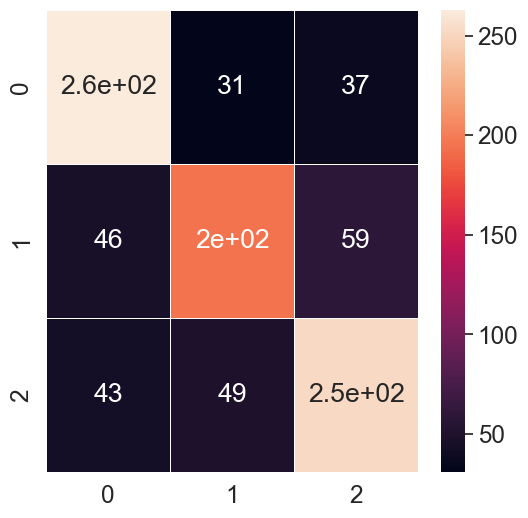

In [288]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, test_prediction)

fig, ax = plt.subplots(figsize=(6,6))         # Sample figsize in inches
sns.set(font_scale=1.6)
sns.heatmap(cm, annot=True, linewidths=.5, ax=ax)


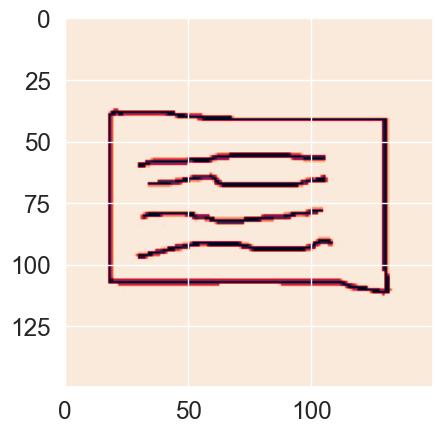

In [285]:
import random
n=random.randint(0, x_test.shape[0]-1) #Select the index of image to be loaded for testing
img = x_test[n]
plt.imshow(img)

In [287]:
input_img = np.expand_dims(img, axis=0) #Expand dims so the input is (num images, x, y, c)
input_img_features=feature_extractor(input_img)
input_img_new = input_img_features.iloc[:,cols]
input_img_new = np.expand_dims(input_img_new, axis=0)
input_img_for_RF = np.reshape(input_img_new, (input_img.shape[0], -1))
#Predict
img_prediction = lgb_model.predict(input_img_for_RF)
img_prediction=np.argmax(img_prediction, axis=1)
img_prediction = le.inverse_transform([img_prediction])  #Reverse the label encoder to original name
print("The prediction for this image is: ", img_prediction)
print("The actual label for this image is: ", test_labels[n])

The prediction for this image is:  [1]
The actual label for this image is:  0


h:\Python\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``gr

In [ ]:
training_data = []

def create_training_data():
    for i in range(len(CATEGORIES)):
        category = CATEGORIES[i]
        path = os.path.join(DATADIR, category)
        for img in os.listdir(path):
            img_array = cv2.imread(os.path.join(path,img))
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
       
            training_data.append([new_array, i])

create_training_data()
len(training_data)

3248

In [ ]:

count_button = 0
count_card = 0 
count_image = 0
for image in training_data:
    if image[1] == 0:
        count_button += 1
    elif  image[1] == 1:
         count_card +=1
    else :
        count_image +=1
print('Button:', count_button, 'Card:', count_card,' Image',count_image)

Button: 1157 Card: 972  Image 1119


In [ ]:
import pandas as pd
df = pd.DataFrame(training_data)

In [ ]:
df.columns=['Image Pixel Value','Output']
df.head()

,Image Pixel Value,Output
0,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0
1,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0
2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0
3,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0
4,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0


In [ ]:
from skimage.filters.rank import entropy
from skimage.morphology import disk
greyscale_img_list = []
for image in df.index:
    # entropy_img = entropy(df['Image Pixel Value'][image],disk(3))
    # entropy_img_list.append(entropy_img)
    final_array = cv2.cvtColor(df['Image Pixel Value'][image],cv2.COLOR_BGR2GRAY)
    greyscale_img_list.append(final_array)

len(greyscale_img_list)


3248

In [ ]:
df=df.assign(GreyScale = greyscale_img_list)

df.head()


,Image Pixel Value,Output,GreyScale
0,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,..."
1,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,..."
2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,..."
3,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,..."
4,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,..."


In [ ]:
from skimage.filters.rank import entropy
from skimage.morphology import disk
entropy_img_list = []
for image in df.index:
    entropy_img = entropy(df['GreyScale'][image],disk(1))
    entropy_img_list.append(entropy_img)



In [ ]:
df=df.assign(Entropy = entropy_img_list)

df.head()

,Image Pixel Value,Output,GreyScale,Entropy
0,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [ ]:
from skimage.filters import sobel
sobel_img_list = []
for image in df.index:
    sobel_img = sobel(df['GreyScale'][image])
    sobel_img_list.append(sobel_img)


In [ ]:
df=df.assign(Sobel = sobel_img_list)

df.head()

,Image Pixel Value,Output,GreyScale,Entropy,Sobel
0,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [ ]:
from scipy import ndimage as nd
gaussian_img_list = []
for image in df.index:
    gaussian_img = nd.gaussian_filter(df['GreyScale'][image],sigma=3)
    gaussian_img_list.append(entropy_img)


In [ ]:
df=df.assign(Gaussian = gaussian_img_list)

df.head()

,Image Pixel Value,Output,GreyScale,Entropy,Sobel,Gaussian
0,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [ ]:
df = df.sample(frac = 1)
df.head()


,Image Pixel Value,Output,GreyScale,Entropy,Sobel,Gaussian
1865,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",1,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1072,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",0,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1460,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",1,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3170,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",2,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1984,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",1,"[[255, 255, 255, 255, 255, 255, 255, 255, 255,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [ ]:

x = df[['GreyScale','Entropy','Sobel','Gaussian']]
y = df['Output']


In [ ]:
x = df[['GreyScale','Entropy','Sobel','Gaussian']].squeeze()

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)

In [ ]:
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D

In [ ]:
training_data.append(greyscale_img_list)
training_data.append(entropy_img_list)
training_data.append(sobel_img_list)
training_data.append(gaussian_img_list)



In [ ]:
from sklearn.naive_bayes import GaussianNB


# instantiate the model
gnb = GaussianNB()


# fit the model
gnb.fit(x_train.squeeze(), y_train)

ValueError: setting an array element with a sequence.

In [ ]:
x